# COMP47700 Speech and Audio PL4: Audio Degradations

## Learning Outcomes
* Describe the signal characteristics of speech and audio signals using
appropriate terminology
  * Understand the importance of simulating degradations.
* Apply signal processing algorithms to speech and audio signals
  * Gain knowledge of clipping distortion and simulate clipping from scratch using Python.
  * Gain knowledge of convolution and impulse response, covering both theory and practical application through Python coding.
  * Understand background noise and SNR concepts.
* Create programmes to conduct experiments on speech and audio samples building on third software libraries
  * Simulate a voice call by sequentially applying degradations and reflecting on the order of degradation.

## Module Topics
Advanced topics Speech and Audio Quality

*   Speech and Audio Quality
*   Objective models of intelligibility and quality

## Why is it important?
* Objective Quality Evaluation:

  * Assessing speech quality in diverse conditions (background noise, packet loss, distortion).
  * Generating artificial degradations facilitates testing quality metrics in realistic scenarios.

* Speech Enhancement and Separation Algorithms:
  * Artificial degradations enable testing these algorithms in diverse real-world conditions.

* Deep Learning:
  * Creating large training datasets with various degradations reduces bias and enhances model generalization.
  * Data augmentation, involving modified speech signal copies, improves performance, especially with limited datasets.

## Structure of this tutorial
This practical tutorial contains different sections:
* **Live coding:** Basic theory, demos and coding examples presented by the lecturer on site (unmarked)
* **Student activity:** Familiarisation and coding exercises to be completed by the students and followed by a short discussion on site (unmarked). These activities introduce key concepts and skills necessary to complete the assignments.


>[COMP47700 Speech and Audio PL4: Audio Degradations](#scrollTo=G1u99MLkem-u)

>>[Learning Outcomes](#scrollTo=QlPWpMNxPt3R)

>>[Module Topics](#scrollTo=QlPWpMNxPt3R)

>>[Why is it important?](#scrollTo=QlPWpMNxPt3R)

>>[Structure of this tutorial](#scrollTo=QlPWpMNxPt3R)

>>[Setup](#scrollTo=bCopdUx1GOtb)

>[Live Coding: Clipping](#scrollTo=DWBZH2Onbe-b)

>>[Coding Part](#scrollTo=VrQFyHf2Zmvp)

>[Live Coding: Room Reverberation](#scrollTo=fBenHw4cfr2v)

>>[Problem Definition](#scrollTo=hKpcwNomdpuR)

>>[Solution](#scrollTo=hKpcwNomdpuR)

>>[Coding Part](#scrollTo=M-fsVBkzMNz8)

>[Student Activity: Background Noise](#scrollTo=16uZOQtEgYZ3)

>>[Problem Definition](#scrollTo=16uZOQtEgYZ3)

>>[Coding Part](#scrollTo=xW_WeSCocm8L)

>[Live Coding: Filtering](#scrollTo=sRSGHKkfPhGp)

>[Assignment](#scrollTo=WIF0uD_meJ8k)

>>[Question 1](#scrollTo=7xTplpQedIes)

>>[Question 2](#scrollTo=5mHd-3qwbZAR)

>>[Question 3](#scrollTo=rw-q951Joa3n)

>>>[Objective](#scrollTo=rw-q951Joa3n)

>>>>[Implementation Steps](#scrollTo=rw-q951Joa3n)

>>>>>[Fixed-Length Packet Loss](#scrollTo=rw-q951Joa3n)

>>>>>[Adaptive (Variable-Length) Packet Loss](#scrollTo=rw-q951Joa3n)

>>>>>[Testing and Analysis](#scrollTo=rw-q951Joa3n)

>>>>>[Analysis Questions](#scrollTo=rw-q951Joa3n)

>[Additional Material](#scrollTo=FzqKey1thTId)



## Setup
Download and unzip data

In [1]:
!wget https://github.com/COMP47700-Speech-and-Audio/PL4-Audio-Degradations/raw/main/PL4_files.zip

--2025-03-08 10:14:23--  https://github.com/COMP47700-Speech-and-Audio/PL4-Audio-Degradations/raw/main/PL4_files.zip
Resolving github.com (github.com)... 140.82.114.4
Connecting to github.com (github.com)|140.82.114.4|:443... connected.
HTTP request sent, awaiting response... 302 Found
Location: https://raw.githubusercontent.com/COMP47700-Speech-and-Audio/PL4-Audio-Degradations/main/PL4_files.zip [following]
--2025-03-08 10:14:24--  https://raw.githubusercontent.com/COMP47700-Speech-and-Audio/PL4-Audio-Degradations/main/PL4_files.zip
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.108.133, 185.199.109.133, 185.199.110.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.108.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 14999148 (14M) [application/zip]
Saving to: ‘PL4_files.zip’

PL4_files.zip       100%[===================>]  14.30M  89.3MB/s    in 0.2s    

2025-03-08 10:14:24 (89.3 MB/s) - ‘PL4

In [2]:
!unzip PL4_files.zip

Archive:  PL4_files.zip
  inflating: Space4ArtGallery.wav    
  inflating: __MACOSX/._Space4ArtGallery.wav  
  inflating: applause.wav            
  inflating: __MACOSX/._applause.wav  
  inflating: CLIP_image_1.png        
  inflating: __MACOSX/._CLIP_image_1.png  
  inflating: CLIP_image_2.png        
  inflating: __MACOSX/._CLIP_image_2.png  
  inflating: CLIP_image_3.png        
  inflating: __MACOSX/._CLIP_image_3.png  
  inflating: concert_hall.wav        
  inflating: __MACOSX/._concert_hall.wav  
  inflating: guitar_sample.flac      
  inflating: __MACOSX/._guitar_sample.flac  
  inflating: R_01_CLIP_MK.wav        
  inflating: __MACOSX/._R_01_CLIP_MK.wav  
  inflating: rir.wav                 
  inflating: __MACOSX/._rir.wav      


In [3]:
import librosa
from librosa import display
import numpy as np
import matplotlib.pyplot as plt
import IPython.display as ipd
import os
import math
import gdown
from IPython.display import Image

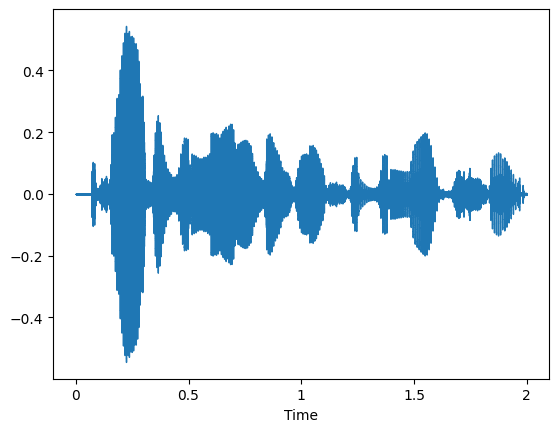

In [4]:
# Loading the clean speech file to a numpy array - x[n].
## We downsample the speech file from 48 kHz (original sampling rate) to 16 kHz
## N.B The command librosa.load automatically represents audio in float 32 bit

# Frequency sampling
sampling_rate = 16000

# Filename
clean_speech_filename = 'R_01_CLIP_MK.wav'

# Load audio file
x, _ = librosa.load(clean_speech_filename, mono=True, sr=sampling_rate)

# Extract 2 seconds from 1s to 3s
x = x[sampling_rate:sampling_rate*3]

#Plot waveform
display.waveshow(x, sr=sampling_rate)

# Player
ipd.Audio(x, rate=sampling_rate, normalize=False)


# **Live Coding**: Clipping
Clipping in the digital domain occurs when we push the signal beyond the possible representation values. Digital signals are represented by a finite number of possible values that can be used to represent the amplitude. For example, in a $16$ bit system, $2^{16} = 65,536$ values are allowed in the range [$-32,768,32,767$]. Let's take an amplitude value that is represented by the number $30,000$ and double it to $60,000$. In this case the value will be truncated to $32,768$ which is the largest value that can be represented in our $16$ bit digital system.




## Coding Part ##
1.   Given a clean speech signal, apply clipping to $10\%$ of the audio samples.

2.   Evaluate the clipped signal (listening and plotting the waveform) by increasing the number of affected samples (e.g. $40\%$).

To clip a percentage of samples in the waveform we use the percentile since we know that if an amplitude value $x[n]$ is at the $k$-th percentile, then $x[n]$ is greater than $k\%$ of the values.
To calculate percentile in python we use the numpy function np.percentile https://numpy.org/doc/stable/reference/generated/numpy.percentile.html

In [5]:
# ***********************************************************************************************
# 1.   Given a clean speech signal, apply clipping to 10\% of the audio samples.
clip_factor = 40
def get_percentile(clip_factor):
  lower_percentile = clip_factor/2
  upper_percentile = 100 - lower_percentile
  percentile_value = np.percentile(x, [lower_percentile, upper_percentile])
  return lower_percentile, upper_percentile , percentile_value


lower_percentile, upper_percentile, percentile_values = get_percentile(clip_factor)
print('Lower percentile: ', lower_percentile)
print('Upper percentile: ', upper_percentile)
print('Percentile values: ', percentile_values)

Lower percentile:  20.0
Upper percentile:  80.0
Percentile values:  [-0.03057637  0.02442523]


We now need to truncate the signal to the percentile values found above.



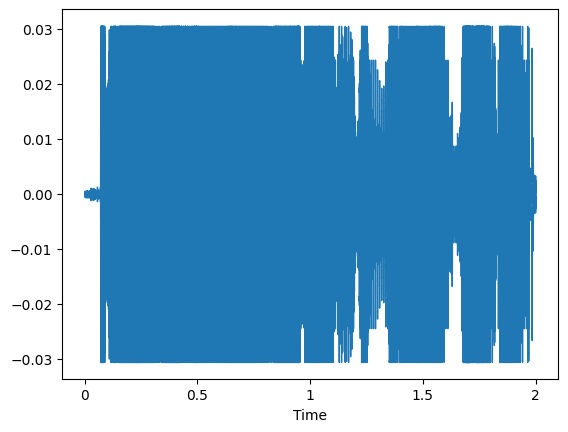

In [6]:
# Obtain clipped signal
def clip_signal(x, percentile_values):
  y = x.copy()
  y[y > percentile_values[1]] = percentile_values[1]
  y[y < percentile_values[0]] = percentile_values[0]
  return y

y = clip_signal(x, percentile_values)
display.waveshow(y, sr=sampling_rate)
ipd.Audio(y, rate=sampling_rate, normalize=False)

The degraded signal is quieter than the original signal since clipping truncates higher peaks. We want that the clean and the degraded signal to have the same loudness since in real-world recordings a degradation does not imply quieter or louder volume.

To match the volume between the two signals several normalization techniques exist:


1.   Peak Normalization
  - $x_{norm}[n]=\frac{x[n]}{\max_\limits{\forall{n}}|x[n]|}$
  - Too sensitive when introducing distortion in the signal
2.   Loudness Normalization
  - Based on normalizing a signal by transforming the average loudness to a target loudness
  - Less sensitive to distortions
  - A simple way is to measure the average power of $x$ using root mean square (RMS) and scaling $y$ so that $RMS_y=RMS_x$
  - More sophisticated techniques are based on human perception (e.g. EBU R 128)

We will use RMS normalization. The RMS of a signal is used to measure the average power $RMS_x = \sqrt{\frac{1}{N}(x{^2_1} + x{^2_2} + ... + x{^2_N})}$.

We want to find a scaling factor $\gamma$ such that $\gamma y[n] \implies RMS_x=RMS_y$.

The scaling factor can be derived from the RMS formula and is equal to $\gamma=\sqrt{\frac{N*RMS_x^2}{\sum_\limits{i=1}^{N}y_i^2}}$


In [7]:
rms_x = np.sqrt(np.mean(x**2))
N = x.shape[0]
gamma = np.sqrt((N*rms_x**2)/np.sum(y**2))
print(f'Scaling Factor: {gamma:.4f}')

y_norm = gamma * y

print(f'RMS of original signal: {rms_x:.3f}')
print(f'RMS of clipped signal: {np.sqrt(np.mean(y**2)):.3f}')
print(f'RMS of normalized clipped signal: {np.sqrt(np.mean(y_norm**2)):.3f}')

ipd.display(ipd.Audio(x, rate=sampling_rate, normalize=False))
ipd.display(ipd.Audio(y, rate=sampling_rate, normalize=False))
ipd.display(ipd.Audio(y_norm, rate=sampling_rate, normalize=False))

Scaling Factor: 2.8586
RMS of original signal: 0.058
RMS of clipped signal: 0.020
RMS of normalized clipped signal: 0.058


Can you hear clipping?
Increase the clip factor to clearly perceive clipping. Notice how the scaling factor for normalisartion changes based on the clip factor.

# **Live Coding**: Room Reverberation

Did you notice that your voice does not sound the same in every room? This is due to the different natural reverberation created by the environment. Sound is affected by the shape of the room and by wall properties.

## Problem Definition
In this exercise, we will see how to simulate a voice recorded in a real-world environment (e.g. art gallery).
To do that we use the convolution operation between the speech clean signal and the impulse response captured in the environment.

Imagine a room as a black box system $H$ that takes an input audio signal that is clean without reverb (e.g. your voice) $x[n]$ and transforms it to $y[n]$. The signal $y[n]$ is still your voice but it has reverb, which depends on the particular room $H$.
What we are trying to get is a representation of $H$ such that every time we want to simulate a voice in this physical environment, we don't need to be physically present there.
This representation is called the impulse response. More specifically, in this case, we call it the room impulse response (RIR).

## Solution
First, we need to be in the room and generate an impulse (e.g. balloon popping) and we record the generated sound. Why an impulsive sound? An impulse covers the frequency spectrum, in this way we know how the room reacts at every frequency.
Once we have the response of the room to our impulse, we can use it to simulate how any other input signal would sound in the same room.

Once we have the clean signal $x[n]$ and the RIR $H$ we need to find a mathematical operation that will describe how $x[n]$ is affected by $H$. This operation is called convolution. Why convolution and not multiplication or a sum? A math proof exists, but a simple intuition lies behind the fact that discrete-time signals can be seen as a sum of several delayed impulses.

In this tutorial, we use RIRs from the EchoThief database http://www.echothief.com/downloads/






## Coding Part ##
1. Plot a RIR waveform in both time and time-frequency domains
2. Calculate the convolution between the clean speech signal and the RIR
3. Plot waveform of original speech and reverberated speech side by side

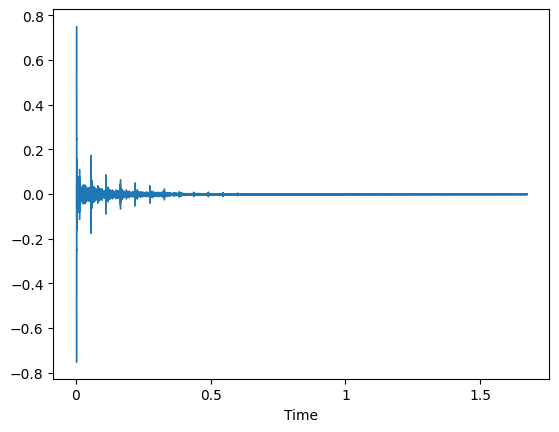

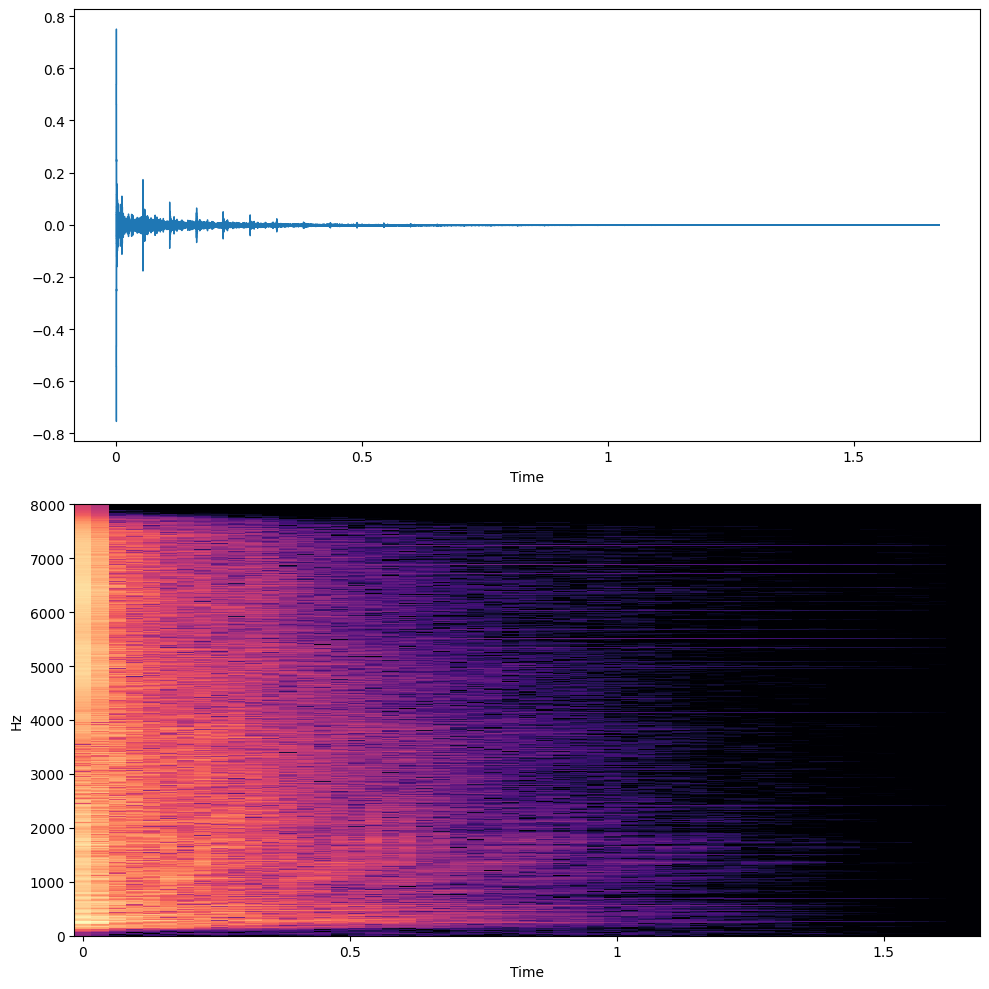

In [8]:
# ***********************************************************************************************
# 1. Plot a RIR waveform in both time and time-frequency domains
rir_filname = 'Space4ArtGallery.wav'
rir, _ = librosa.load(rir_filname, mono=True, sr=sampling_rate)
display.waveshow(rir, sr=sampling_rate)
ipd.Audio(rir, rate=sampling_rate, normalize=False)

fig, axs = plt.subplots(2, 1, figsize=(10, 10))
display.waveshow(rir, sr=sampling_rate, ax=axs[0])
librosa.display.specshow(librosa.amplitude_to_db(np.abs(librosa.stft(rir)), ref=np.max), sr=sampling_rate, x_axis='time', y_axis='hz', ax=axs[1])
plt.tight_layout()
plt.show()

Scaling factor:  0.4136


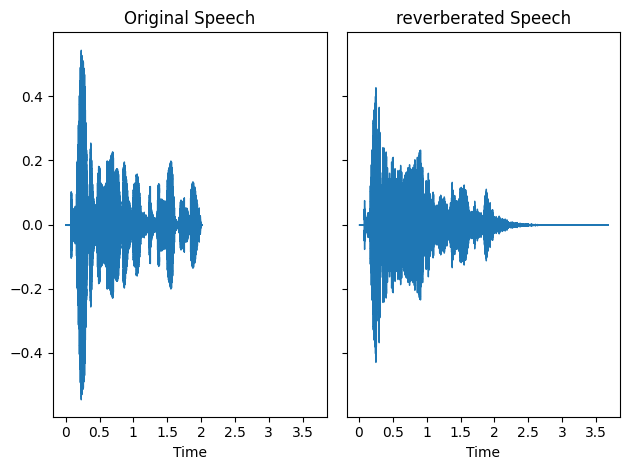

In [9]:
# ***********************************************************************************************
# 2. Calculate the convolution between the clean speech signal and the RIR
y = np.convolve(x, rir)

gamma = np.sqrt((N*rms_x**2)/np.sum(y**2))
print(f'Scaling factor: {gamma: .4f}')

y_norm = gamma * y

fig, axs = plt.subplots(1, 2, sharex=True, sharey = True)
display.waveshow(x, sr=sampling_rate, ax=axs[0])
axs[0].set_title('Original Speech')
display.waveshow(y_norm, sr=sampling_rate, ax=axs[1])
axs[1].set_title('reverberated Speech')
plt.tight_layout()

ipd.display(ipd.Audio(x, rate=sampling_rate, normalize=False))
ipd.display(ipd.Audio(y_norm, rate=sampling_rate, normalize=False))

The principle of the impulse response is used to simulate other devices that transform an input signal. For example, we could use the impulse response to simulate a speaker or a vinyl disc. Once the impulse response of these devices is available, the same convolution-based approach that we have seen above can be used.

# **Student Activity**: Background Noise
Background noise can be added to a clean signal to simulate the presence of external sound sources that can affect the quality of a video call (e.g. traffic, keyboard typing, competing speaker).

## Problem Definition
To adjust how strong is the noise in the corrupted signal we use the concept of signal-to-noise ratio (SNR):

- $ \mathrm{SNR} = \frac{P_{signal}}{P_{noise}} $

- $ \mathrm{SNR_{dB}} = 10 \log _{{10}} \mathrm {SNR} $.

The SNR is the ratio between speech and noise power, it is typically expressed in dB instead of linear scale. The average power of a signal can be measured with the root mean squared (RMS) of the signal calculated as: $ P_x = \sqrt{\frac{1}{N}(x{^2_1} + x{^2_2} + ... + x{^2_n})} $ where $N$ is the length of the signal $x$

Simulating noisy speech consists of summing a scaled noise signal with the speech signal. To scale the noise signal we need to calculate the desired noise power which depends on the SNR value that we choose.

- 1) Choose an SNR value in dB: $\mathrm{SNR_{dB}}$
- 2) Convert the SNR value from dB to linear: $\mathrm{SNR}=10^{\frac{\mathrm{SNR_{dB}}}{10}}$
- 3) Calculate the desired noise power: $\widehat{P}_{noise}=\frac{P_{signal}}{\mathrm{SNR}}$
- 4) Scale the noise using the desired noise power: $\hat{s}[n] = s[n] * \frac{\widehat{P}_{noise}}{P_{noise}}$
 - $s[n]$ is the original noise signal
 - $\hat{s}[n]$ is the scaled noise signal
 - $P_{noise}$ is the original noise power (RMS)
 - $\widehat{P}_{noise}$ is the desired noise power (RMS)
 - The ratio $\alpha=\frac{\widehat{P}_{noise}}{P_{noise}}$ is the scaling factor.
    - $\alpha=1$ when $P_{noise}=\widehat{P}_{noise}$ which is true when we chose an SNR that is equal to the original SNR
    - If we increase the SNR, the desired power $\widehat{P}_{noise}$ is lower than the original noise power
    - So, the scaling factor is relative to the original SNR
- 5) Sum the two signals: $y[n] = x[n] + \alpha*s[n]$


## Coding Part ##
1. Add applause noise to a clean speech signal using SNR of 5 dB
2. Plot waveform and spectrogram of the noise signal
3. Plot waveform of speech and noisy signal side by side

In [10]:
# Note: Speech and background signals must have the same length in order to be summed together. This is never the case.
# If the background signal is shorter, we repeat it until reaching the length of the speech signal.
# If the speech signal is shorter, we just truncate the background signal to the length of the speech signal.

# ***********************************************************************************************
# 1. Add noise to a clean speech signal using SNR of 5 dB
snr_db = 10
def add_noise(x, s, snr_db):
  x_len = x.shape[0]
  s_len = s.shape[0]
  if s_len < x_len:
    reps = math.ceil(x_len/s_len)
    s = np.tile(s, reps)
  s = s[:x_len]
  assert x_len == s.shape[0]
  snr = 10**(snr_db/10)

  xp = np.sqrt(np.mean(x**2))
  sp = np.sqrt(np.mean(s**2))

  sp_target = xp/snr
  alpha = sp_target/sp

  y = x + alpha*s
  return y

snr_db = 10
noise_filename = 'applause.wav'
noise, _ = librosa.load(noise_filename, mono=True, sr=sampling_rate)
y = add_noise(x, noise, snr_db)


In [11]:
# ***********************************************************************************************


# **Live Coding**: Filtering
Filtering audio modifies the frequency content of a sound.
A digital filter can be represented as a difference equation:

$y[n] = b_0 x[n] + b_1 x[n-1] + ... + b_M x[n-M]$

where:

* $y[n]$ is the output signal at time n
* $x[n]$ is the input signal at time n
* $b_i$ are the filter coefficients
* M is the filter order

The 'b' coefficients determine the filter's characteristics
(cutoff frequency, type, etc.). They define the filter's transfer function,
which describes how the filter affects different frequencies.

Designing a filter means finding the appropriate coefficients 'b'.

**Types of filters:**

* **Low-pass:** Allows frequencies below a cutoff frequency to pass through.
* **High-pass:**  Allows frequencies above a cutoff frequency to pass through.
* **Band-pass:** Allows frequencies within a specific range to pass through.

In the Python example below, `firwin` calculates these 'b' coefficients for a low-pass filter.

# **Assignment**

## **Question 1**
1. Given these 3 plots (a,b,c). Indicate which plot is unclipped, clipped, or clipped + normalized and explain why


(a)


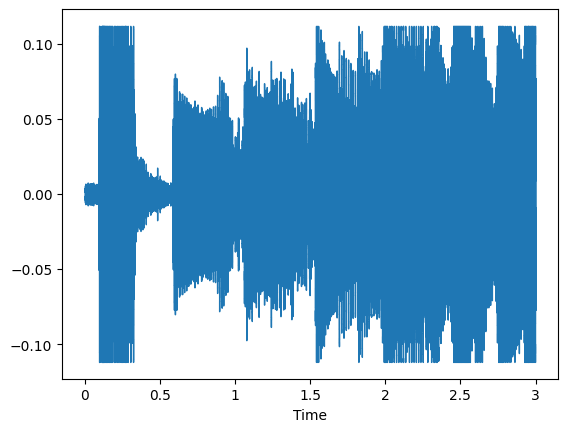

(b)


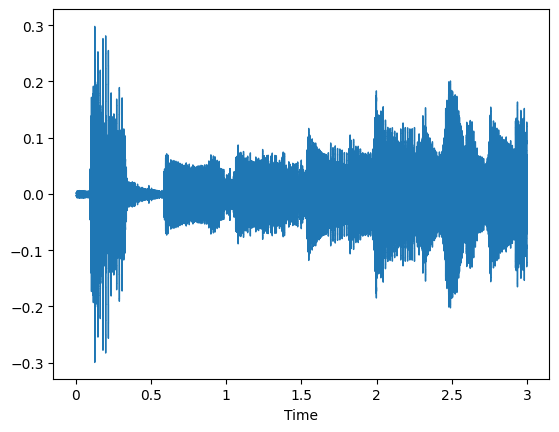

(c)


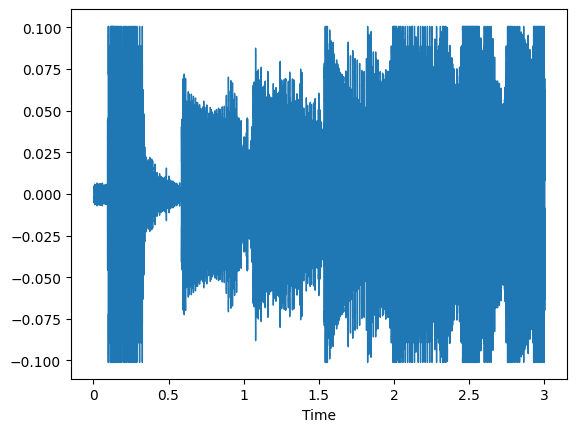

In [12]:
print('(a)')
ipd.display(Image('CLIP_image_1.png'))
print('(b)')
ipd.display(Image('CLIP_image_2.png'))
print('(c)')
ipd.display(Image('CLIP_image_3.png'))

A) **Image (a): Clipped + Normalized**

In this waveform, we notice flat-topped (and/or flat-bottomed) segments where the peaks have been “cut off.” This indicates that the signal exceeded the maximum level, resulting in clipping. After this clipping occurred, the entire waveform was normalized—in other words, its overall volume was boosted so that it fills the full available range. While the signal sounds much louder, the clipped sections remain visibly distorted.

B) **Image (b): Unclipped (Clean Signal)**

This image shows a smooth, flowing waveform with gently curving peaks and valleys. There are no flat segments, which means the signal never reached a level that would cause clipping. The recording is clean and natural, accurately representing the original audio dynamics without any distortion.

C) **Image (c): Clipped (Without Normalization)**

Here, you can see that the waveform has clear flat areas indicating clipping, just like in image (a). However, unlike image (a), there is no normalization applied afterward. As a result, the overall amplitude is noticeably lower. The signal is still distorted in the clipped sections, but it isn’t as loud overall since it wasn’t boosted to fill the full dynamic range.

2.  In artificial reverberation, which specific problem does the impulse response solve? Use max 300 characters.

    Impulse Response (IR) solves the problem of simulating the acoustics of a physical space.

      An IR captures how a space (such as a concert hall or room) reacts to an impulsive sound.
      It records the reflections, decay, and covers the frequency spectrum, in this way we know how the room reacts at every frequency.
      Once we have the IR, we convolve it with a clean signal x[n]—treating the signal as a sum of delayed impulses—to naturally recreate the room's echoes and decay.

## **Question 2**

Design a system that simulates a live recording of a clean guitar sample (guitar_sample.flac) in a concert hall (concert_hall.wav)
with audience applause (applause.wav) mixed at 15 dB SNR. Due to some issues with the recording equipment,
0.001% of the audio samples are corrupted by clipping.

  1. Indicate the order of the degradations and explain why this is your choice

  2. Generate the degraded file by using the functions created during the lab and add players to hear both clean and degraded signals. The two signals must be easy to play and to compare

## Solution

### Order of Degradations
Alright, Before starting our algorithm, lets discuss the order of all the degradations first.

1. Apply Concert Hall Reverberation:

  Reason: Convolution with the concert hall impulse response simulates the natural reflections and acoustics of the venue. This must be applied to the clean guitar sample first so that the room characteristics affect the entire sound.

2. Mix Audience Applause at 15 dB SNR:

  Reason: In a live recording, audience noise is present. By mixing applause at a controlled Signal-to-Noise Ratio (15 dB), we ensure that the guitar remains dominant while still incorporating realistic background noise. Noise is added after reverb so that the noise isn’t also “colored” by the reverb process.

3. Introduce Clipping (0.001% of Samples):

  Reason: Clipping simulates an equipment malfunction or digital error. It is applied last so that the previously added effects (reverb and noise) remain intact. Clipping is applied only to a very small percentage of samples to mimic sporadic recording issues.

Let's start with Implementation.

Imports

In [13]:
import numpy as np
import librosa
import soundfile as sf
import IPython.display as ipd
import librosa.display
import matplotlib.pyplot as plt


Let's start with loading Audio Files
We will load the clean guitar sample (FLAC file). We will Use sr=None to preserve original sampling rate.

In [14]:
guitar, sr = librosa.load("guitar_sample.flac", sr=None)

Let's Load the impulse response of the concert hall. Ensure the sampling rate matches and audience applause audio.

In [15]:
reverb_ir, _ = librosa.load("concert_hall.wav", sr=sr)
applause, _ = librosa.load("applause.wav", sr=sr)

Next step is to apply Concert Hall Reverberation

Reverberation is simulated by convolving the clean guitar signal with the impulse response.We use 'full' convolution and then truncate to the original length.

In [16]:
reverberated_guitar = np.convolve(guitar, reverb_ir, mode='full')[:len(guitar)]

Great! Our reverberated_guitar is ready, lets hear it.

Original


Reverberated


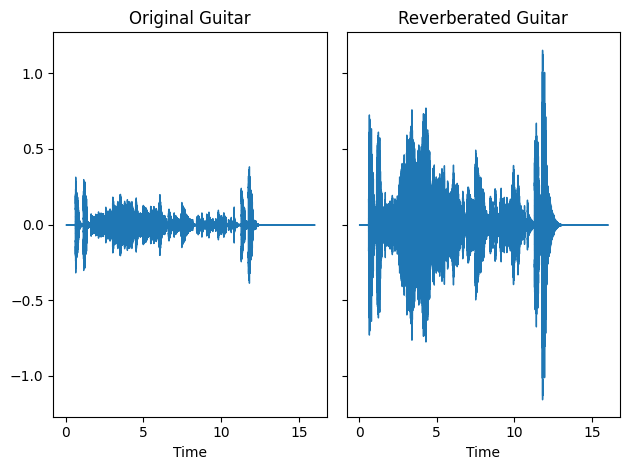

In [17]:
fig, axs = plt.subplots(1, 2, sharex=True, sharey = True)
display.waveshow(guitar, sr=sr, ax=axs[0])
axs[0].set_title('Original Guitar')
display.waveshow(reverberated_guitar, sr=sr, ax=axs[1])
axs[1].set_title('Reverberated Guitar')
plt.tight_layout()

ipd.display(ipd.Audio(guitar, rate=sr))
print("Original")
ipd.display(ipd.Audio(reverberated_guitar, rate=sr))
print("Reverberated")

Sounds Amazing right! 🙂.

Next, we need to add audience applause at 15 dB SNR(Signal to Noise Ratio).

We will use the existing add_noise function which is defined above in the code abd mix the reverberated guitar with applause at 15 dB SNR

In [18]:
guitar_with_applause = add_noise(reverberated_guitar, applause, snr_db=15)

Let's hear it and see it all.
1. Original Guitar
2. Reverberated Guitar
3. Reverberated Guitar with Audience applause (Sounds cool right 😎)

Original


Reverberated


Reverberated with Applause


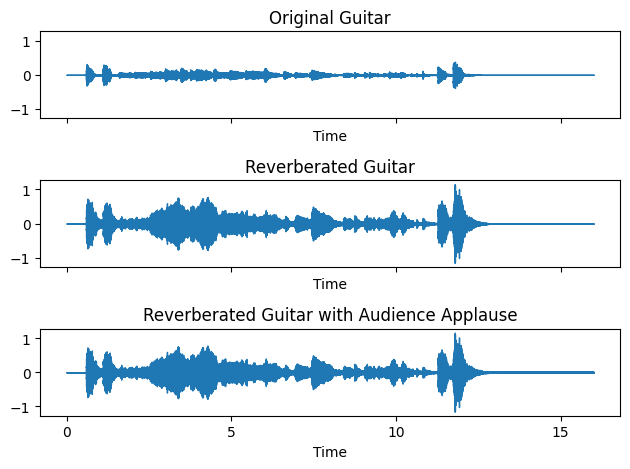

In [19]:
fig, axs = plt.subplots(3, 1, sharex=True, sharey = True)
display.waveshow(guitar, sr=sr, ax=axs[0])
axs[0].set_title('Original Guitar')
display.waveshow(reverberated_guitar, sr=sr, ax=axs[1])
axs[1].set_title('Reverberated Guitar')
display.waveshow(guitar_with_applause, sr=sr, ax=axs[2])
axs[2].set_title('Reverberated Guitar with Audience Applause')
plt.tight_layout()

ipd.display(ipd.Audio(guitar, rate=sr))
print("Original")
ipd.display(ipd.Audio(reverberated_guitar, rate=sr))
print("Reverberated")
ipd.display(ipd.Audio(guitar_with_applause, rate=sr))
print("Reverberated with Applause")

Insanely Good Right 🎸

Well this doesn't end here, we have to introduce Clipping to 0.001% of samples, for that we will create a function (Exactly same as we did in the lab just with another paramater so it takes signal as well, you know making it more robust) which will take the clip factor and signal as input and return us percentile values of clipping.

In [20]:
def get_percentile_thresholds(signal, clip_factor):
    lower_percentile = clip_factor / 2
    upper_percentile = 100 - lower_percentile
    percentile_values = np.percentile(signal, [lower_percentile, upper_percentile])
    return percentile_values

Now, based on this percentile value we can will have the upper and lower threshold values.

In [21]:
clip_factor = 0.001
percentile_values = get_percentile_thresholds(guitar_with_applause, clip_factor)
print(percentile_values)

[-1.11326644  1.00973343]


That's the upper and lower threshold values of our signal below/above which we will truncate the signal to these percentile values.



Let's define a function to clip signal, we will take the original signal and percentile value and will return truncated Signal

In [22]:
def clip_signal(signal, percentile_values):
    clipped_signal = np.copy(signal)
    clipped_signal[clipped_signal > percentile_values[1]] = percentile_values[1]
    clipped_signal[clipped_signal < percentile_values[0]] = percentile_values[0]
    return clipped_signal

Great, let's use this function to truncate our guitar signal with audience applauding.

In [23]:
guitar_clipped = clip_signal(guitar_with_applause, percentile_values)

Let's save the final degraded signal to a file

In [24]:
sf.write("degraded_guitar.wav", guitar_clipped, sr)

Wooooo! Too much stuff right ?? We took the original signal, then added reverberation into it and then even added audience applauding and finally clipped the 0.001% of the signal. **Let's see both and compare side by side the the original with the final degraded.**

In [25]:
print("Original Guitar Sample:")
ipd.display(ipd.Audio("guitar_sample.flac", rate=sr))

print("Degraded Guitar Sample (With Clipping):")
ipd.display(ipd.Audio("degraded_guitar.wav", rate=sr))

Original Guitar Sample:


Degraded Guitar Sample (With Clipping):


Well, with just audio you hear the difference, but let's see the waveform and spectogram to see the difference between the 2 very clearly.

<ipython-input-26-3f5ed0b26256>:17: UserWarning: amplitude_to_db was called on complex input so phase information will be discarded. To suppress this warning, call amplitude_to_db(np.abs(S)) instead.
  D_original = librosa.amplitude_to_db(librosa.stft(guitar), ref=np.max)
<ipython-input-26-3f5ed0b26256>:24: UserWarning: amplitude_to_db was called on complex input so phase information will be discarded. To suppress this warning, call amplitude_to_db(np.abs(S)) instead.
  D_degraded = librosa.amplitude_to_db(librosa.stft(guitar_clipped), ref=np.max)


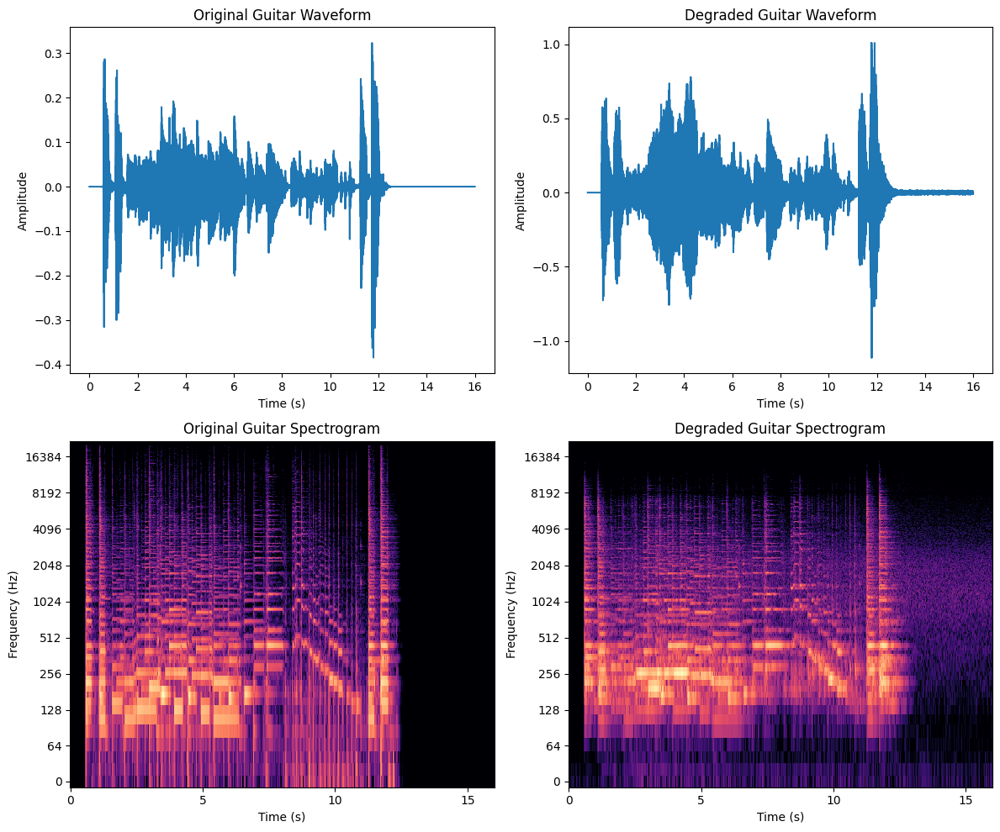

In [26]:
  # Plotting setup
fig, axes = plt.subplots(2, 2, figsize=(12, 10))

# Original Audio Waveform
axes[0, 0].plot(np.linspace(0, len(guitar) / sr, len(guitar)), guitar)
axes[0, 0].set_title("Original Guitar Waveform")
axes[0, 0].set_xlabel("Time (s)")
axes[0, 0].set_ylabel("Amplitude")

# Degraded Audio Waveform
axes[0, 1].plot(np.linspace(0, len(guitar_clipped) / sr, len(guitar_clipped)), guitar_clipped)
axes[0, 1].set_title("Degraded Guitar Waveform")
axes[0, 1].set_xlabel("Time (s)")
axes[0, 1].set_ylabel("Amplitude")

# Spectrogram of Original Audio
D_original = librosa.amplitude_to_db(librosa.stft(guitar), ref=np.max)
librosa.display.specshow(D_original, sr=sr, x_axis='time', y_axis='log', ax=axes[1, 0])
axes[1, 0].set_title("Original Guitar Spectrogram")
axes[1, 0].set_xlabel("Time (s)")
axes[1, 0].set_ylabel("Frequency (Hz)")

# Spectrogram of Degraded Audio
D_degraded = librosa.amplitude_to_db(librosa.stft(guitar_clipped), ref=np.max)
librosa.display.specshow(D_degraded, sr=sr, x_axis='time', y_axis='log', ax=axes[1, 1])
axes[1, 1].set_title("Degraded Guitar Spectrogram")
axes[1, 1].set_xlabel("Time (s)")
axes[1, 1].set_ylabel("Frequency (Hz)")
plt.tight_layout()
plt.show()


Well, that's it for 2nd Question, it's much easier to see the difference now with these plots.

## **Question 3**

This assignment focuses on simulating packet loss in speech signals and analyzing its effects. Packet loss, a common network issue, occurs when transmitted data packets (in this case, audio frames) fail to reach their destination. This results in gaps of silence, leading to degraded, choppy audio quality. Your task is to design and implement a system that allows you to control and observe the impact of packet loss.

### Objective

Design and implement algorithms that simulate packet loss in a speech signal, allowing for control over the percentage of lost packets. You will implement both fixed-length and adaptive (variable-length) packet loss scenarios. You will then analyze the effects of this loss on the audio signal, both aurally and visually (using spectrograms).

#### Implementation Steps

##### 1. Fixed-Length Packet Loss

Implement a function `fixed_packet_loss(signal, packet_length, loss_percentage, seed=42)` that simulates the loss of packets with a *constant*, predefined length.

*   `signal`: The input audio signal (a NumPy array).
*   `packet_length`: The length of each packet to be lost (in *milliseconds*).
*   `loss_percentage`: The percentage of packets to be lost (e.g., 10 for 10%).
*   `seed`: An integer seed for the random number generator (for reproducibility).
*   The function should return the modified signal with simulated packet loss. Ensure the packet loss distortion is clearly audible.
* *Note: Lost packets should not overlap.*

##### 2. Adaptive (Variable-Length) Packet Loss

Implement a function `adaptive_packet_loss(signal, min_packet_length, max_packet_length, loss_percentage, seed=42)` that simulates packet loss where the length of each lost packet varies.

*   `signal`: The input audio signal.
*   `min_packet_length`: The minimum length of a lost packet (in *milliseconds*).
*   `max_packet_length`: The maximum length of a lost packet (in *milliseconds*).
*   `loss_percentage`: The percentage of packets to be lost (e.g., 10 for 10%).
*   `seed`: An integer seed for the random number generator.
*   The function should return the modified signal. Ensure the packet loss distortion is clearly audible.
* *Note: Lost packets should not overlap.*

##### 3. Testing and Analysis

*   Use the provided audio file 'R_01_CLIP_MK.wav' as your test signal.
*   Apply both `fixed_packet_loss` and `adaptive_packet_loss` to the test signal.
*   Generate and plot spectrograms for:
    *   The original, clean speech signal.
    *   The signal with fixed-length packet loss.
    *   The signal with adaptive-length packet loss.
*   Include audio players for each of the three signals so that the differences can be heard.

##### 4. Analysis Questions

*   **a)** Describe the visual differences (abnormalities) observed in the spectrograms of the signals with fixed and adaptive packet loss, compared to the clean signal's spectrogram. Be specific about what features you see (or don't see).

*   **b)** Correlate the visual abnormalities you observed in the spectrograms with the auditory effects you hear in the processed audio. Explain *how* the visual changes relate to the perceived sound quality degradation.




## Solution

Imports

In [27]:
import numpy as np
import librosa
import matplotlib.pyplot as plt
import librosa.display
import IPython.display as ipd

Let's load the test clean speech signal ensuring sampling rate is preserved.

In [28]:
speech, sr = librosa.load("R_01_CLIP_MK.wav", sr=None)

Let's listen and plot its waveform.

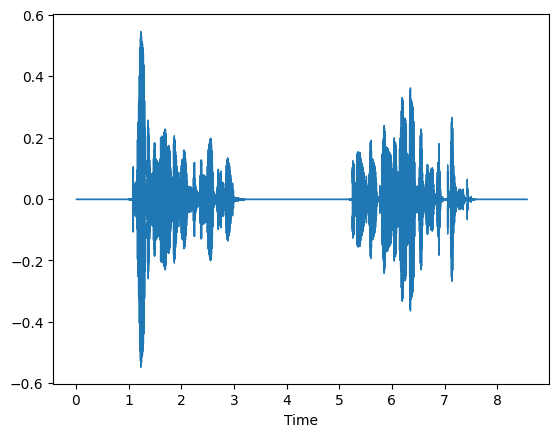

In [29]:
display.waveshow(speech, sr=sr)
ipd.Audio(speech, rate=sr, normalize=False)

**1) Fixed-Length Packet Loss**

Let's start with Fixed-Length Packet Loss Implementation first. For that lets create a function and take inputs as stated above and we will return the modified signal with fixed-length packets set to zero.

The function will split the audio signal into packets of fixed length.
Randomly choose a certain percentage of these packets to “drop” (i.e., set to zero).
Ensuring packets do not overlap.

In [30]:
def fixed_packet_loss(signal, packet_length_ms, loss_percentage, sr, seed=42):
    np.random.seed(seed) # Calculate the number of samples per packet.
    packet_length = int((packet_length_ms / 1000) * sr)

    # Total number of full packets in the signal and
    # then we Randomly choose packets which we will drop
    num_packets = len(signal) // packet_length
    num_packets_to_drop = int(num_packets * loss_percentage / 100)
    lost_packets = np.random.choice(num_packets, num_packets_to_drop, replace=False)

    # Lets Create a copy of the signal to modify. So our original signal will remain as it is.
    signal_copy = np.copy(signal)

    # Once we have lost packets lets iterave over each packet and zero out the corresponding samples.
    for p in lost_packets:
        start = p * packet_length
        signal_copy[start: start + packet_length] = 0

    return signal_copy

Our function is ready, lets apply the function to our speech with packet loss: 20 ms packets, 10% loss.

In [31]:
fixed_loss_signal = fixed_packet_loss(speech, packet_length_ms=20, loss_percentage=10, sr=sr)

Let's hear and visualise this fixed loss signal.

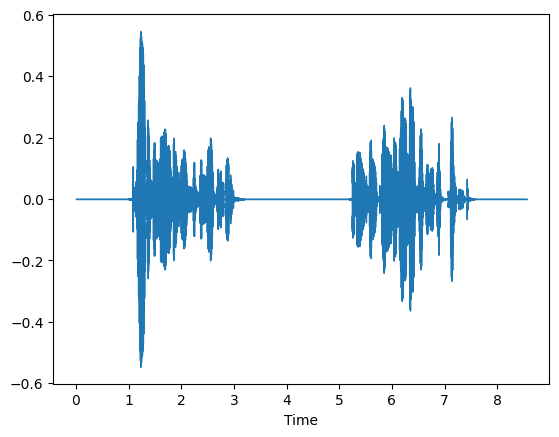

In [32]:
display.waveshow(fixed_loss_signal, sr=sr)
ipd.Audio(fixed_loss_signal, rate=sr, normalize=False)

Did you see this ?? 😯

We can clearly hear small distortions in the sound now. We will do proper analysis of this in part 3.

**2) Adaptive (Variable-Length) Packet Loss**

Moving on to next function which will be Adaptive (Variable-Length) Packet Loss, For this implementation we will create a function and take inputs as stated above and we will return the modified signal with variable-length packets set to zero.

Instead of fixed-length packets, we will select random packet lengths between a minimum and maximum value and then randomly drop these packets until the desired percentage of lost samples is reached.
Again, ensure no overlapping packets.

In [33]:
def adaptive_packet_loss(signal, min_packet_length_ms, max_packet_length_ms, loss_percentage, sr, seed=42):

    np.random.seed(seed) # Calculate the number of samples per packet.
    signal_copy = np.copy(signal) # Lets Create a copy of the signal to modify. So our original signal will remain as it is.
    total_samples = len(signal)

    # Total number of samples to drop based on loss percentage.
    num_lost_samples_target = int(total_samples * loss_percentage / 100)
    lost_samples = 0

    # Continue dropping packets until the target number of lost samples is reached.
    while lost_samples < num_lost_samples_target:
        # We will choose a packet length between the min and max limits randomly
        # and we will also randomly choose a start index for the packet (ensure it fits within the signal)
        packet_length_ms = np.random.randint(min_packet_length_ms, max_packet_length_ms)
        packet_length = int((packet_length_ms / 1000) * sr)
        start = np.random.randint(0, total_samples - packet_length)

        # Once we get that random value we will set the selected packet to zero.
        signal_copy[start: start + packet_length] = 0
        lost_samples += packet_length

    return signal_copy

Our function is ready, Let's apply adaptive packet loss: packets between 10 ms and 50 ms, 10% total loss.

In [34]:
adaptive_loss_signal = adaptive_packet_loss(speech, min_packet_length_ms=10, max_packet_length_ms=50, loss_percentage=10, sr=sr)

Let's hear and visualise the signal in waveform.

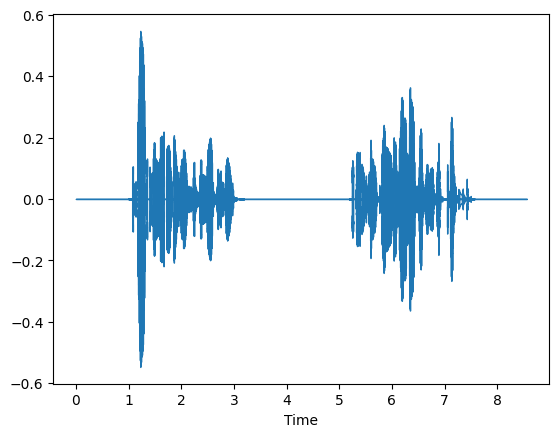

In [35]:
display.waveshow(adaptive_loss_signal, sr=sr)
ipd.Audio(adaptive_loss_signal, rate=sr, normalize=False)

Did you see this too ?? Did you hear how distorted or glitchy it is. well thats what packet loss or network issue sometimes do this to our voice too. Let's analysis these audio's with spectogram and proceed to 3rd part of this question.

**3) Testing and Analysis**

For testing and analysis obviously we will use the provided speech file R_01_CLIP_MK.wav as the test signal. (which we already did above). We will Plot spectrograms of the clean speech, fixed-length packet loss version, and adaptive packet loss version and provide audio players for side-by-side listening and visual comparison.

Let's do it properly so we don't have to write same code again and again, we will create a function to plot spectogram which will take the below parameters:
- signal: Input audio signal.
- sr: Sampling rate.
- title: Title of the plot.

and plots the spectrogram of an audio signal.

In [36]:
def plot_spectrogram(signal, sr, title):
    plt.figure(figsize=(10, 4))
    S = librosa.amplitude_to_db(np.abs(librosa.stft(signal)), ref=np.max)
    librosa.display.specshow(S, sr=sr, x_axis="time", y_axis="log")
    plt.colorbar(format="%+2.0f dB")
    plt.title(title)
    plt.tight_layout()
    plt.show()

Using this function we will create spectogram for all our 3 signals and will also add the audio playback for comparison.

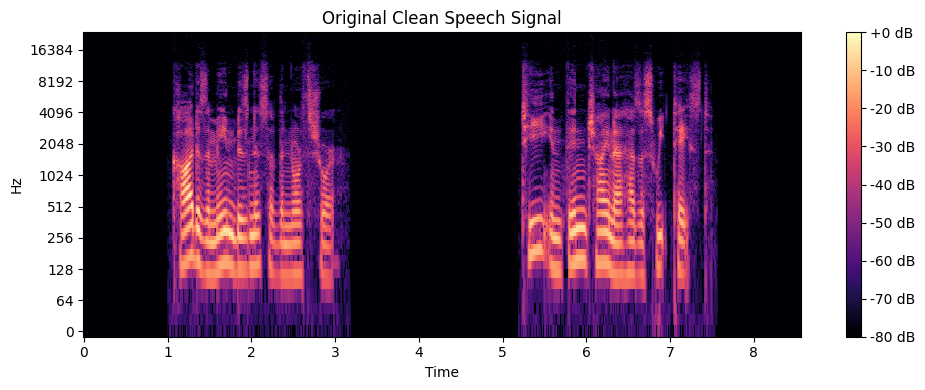

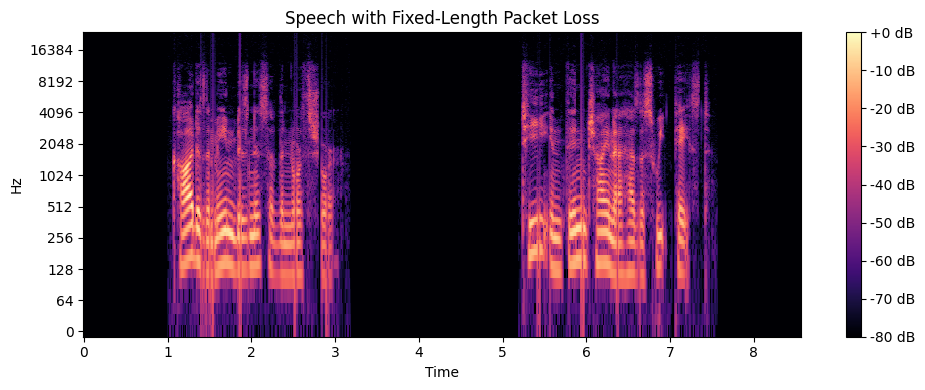

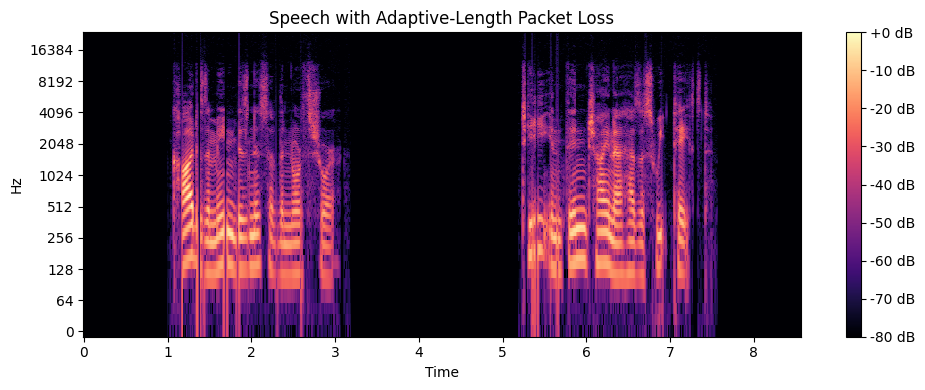

Original Speech Signal:


Speech with Fixed-Length Packet Loss:


Speech with Adaptive-Length Packet Loss:


In [37]:
# Plotting spectrograms
plot_spectrogram(speech, sr, "Original Clean Speech Signal")
plot_spectrogram(fixed_loss_signal, sr, "Speech with Fixed-Length Packet Loss")
plot_spectrogram(adaptive_loss_signal, sr, "Speech with Adaptive-Length Packet Loss")


#Audio Playback for Comparison
print("Original Speech Signal:")
ipd.display(ipd.Audio(speech, rate=sr))
print("Speech with Fixed-Length Packet Loss:")
ipd.display(ipd.Audio(fixed_loss_signal, rate=sr))
print("Speech with Adaptive-Length Packet Loss:")
ipd.display(ipd.Audio(adaptive_loss_signal, rate=sr))

#### 4) Analysis Questions**

**(a) Visual Differences in Spectrograms**

**Original Signal**:
When looking at the spectrogram of the clean speech signal, everything appears smooth and continuous. You can clearly see the formants and harmonics, which are the natural frequency components of human speech. There are no sudden breaks or missing sections—just a well-defined flow of energy over time.

**Fixed-Length Packet Loss:**
With fixed-length packet loss, the spectrogram starts to show periodic vertical gaps where information is missing. These gaps occur at regular intervals because the lost packets are all of the same duration and happen at predictable points. Visually, these gaps look like thin, evenly spaced stripes where the signal energy is suddenly missing. If you listen to the audio, you'll hear short, rhythmic dropouts, making it sound robotic or choppy.


**Adaptive-Length Packet Loss:**
With adaptive-length packet loss, things get more chaotic. The gaps in the spectrogram are not evenly spaced, and their width varies because different-sized chunks of audio are randomly removed. This makes the missing information less predictable compared to fixed-length packet loss. If you were to listen to it, you’d notice a more irregular, broken-up sound—almost like intermittent signal interference or a bad phone connection where words cut off unpredictably.


**(b) Correlation Between Visual and Auditory Effects**

**Fixed-Length Packet Loss Audio:**
When packet loss occurs at fixed intervals, the effect on the audio is very structured. The consistent gaps in the spectrogram directly translate to periodic interruptions in the sound, making speech feel robotic, choppy, or stuttered. Since the missing information is evenly spaced, the brain can sometimes predict the pattern, but it still makes speech harder to understand. It sounds as if words are getting “cut up” into pieces at a regular rhythm, almost like a skipping CD or a poor-quality VoIP call.

**Adaptive-Length Packet Loss Audio**
With adaptive packet loss, the missing sections are unpredictable, which means the speech quality deteriorates in a more chaotic way. Unlike fixed packet loss, where dropouts follow a pattern, this variation makes speech sound more glitchy, garbled, and inconsistent. The gaps in the spectrogram reflect this randomness, with missing chunks appearing at irregular intervals and different durations. Audibly, this results in unexpected silences and distortions, making it much harder to follow what is being said.

## Thank you

# ***Additional Material***
Useful links if you are interested in exploring this topic.

*   Freesound https://freesound.org/
  * Find impulse responses, background noise signals, general sounds
*   Echothief http://www.echothief.com/downloads/
  * Impulse responses professionally recorded. Over a hundred unique spaces from around North America: caves, skateparks, stairwells, underpasses, glaciers, fortresses, and more.
* Clean speech datasets https://github.com/jim-schwoebel/voice_datasets
* PyTorch audio augmentations (deep learning) https://github.com/iver56/audiomentations
* Pedalboard https://spotify.github.io/pedalboard/
  * Useful if you want to manipulate clean audio with audio plugins via python. Several effects used in music productions




